## Training Model

In [1]:
import pandas as pd 
import os 
from skimage.transform import resize 
from skimage.io import imread 
import numpy as np 
import joblib
import matplotlib.pyplot as plt 
from sklearn import svm 
from sklearn.model_selection import GridSearchCV 
from sklearn.model_selection import train_test_split 
from sklearn.metrics import accuracy_score 
from sklearn.metrics import classification_report
from PIL import Image

In [2]:
def process_image(image_path):
    image1 = Image.open(image_path)

    # Langkah 1: Potong gambar
    width, height = image1.size
    x,y = 400,200
    cropped_image = image1.crop((x, y, width-300, height-100))

    # Langkah 2: Konversi ke grayscale
    gray_image = cv2.cvtColor(np.array(cropped_image), cv2.COLOR_BGR2GRAY)

    # Langkah 3: Thresholding
    thresholded_image = gray_image.copy()
    otsu_threshold, image_result = cv2.threshold(thresholded_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    threshold_value = 128
    thresholded_image[gray_image > threshold_value] = 255

    #plt.imshow(image_result, cmap='gray') 
    #plt.axis('off')
    #plt.show()

    return image_result

loading... category : Botol Bagus


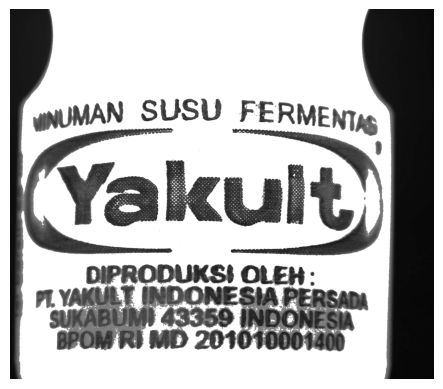

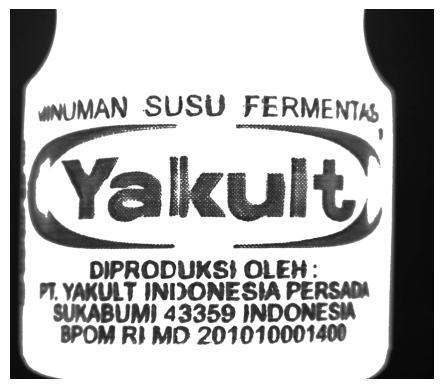

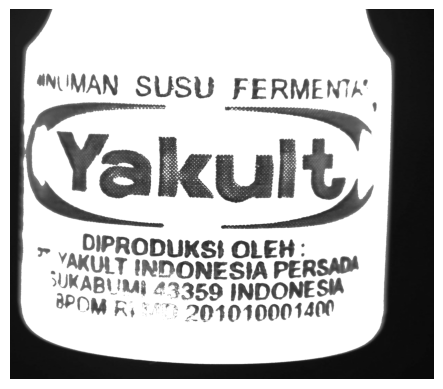

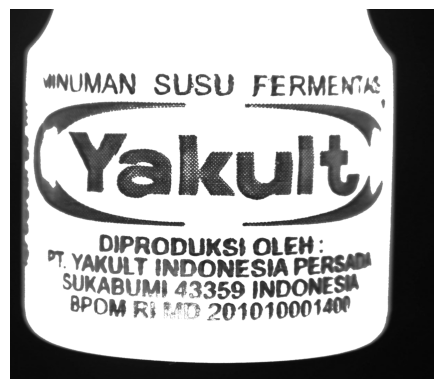

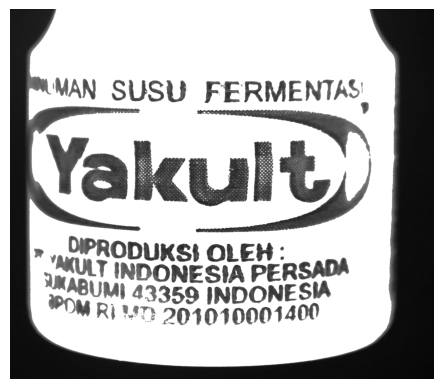

...

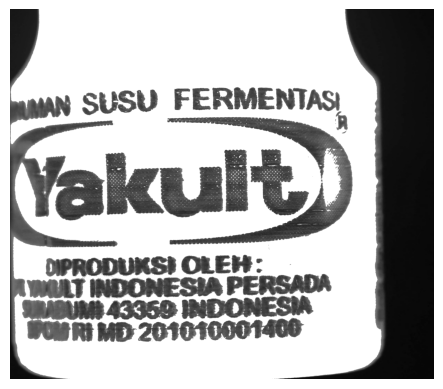

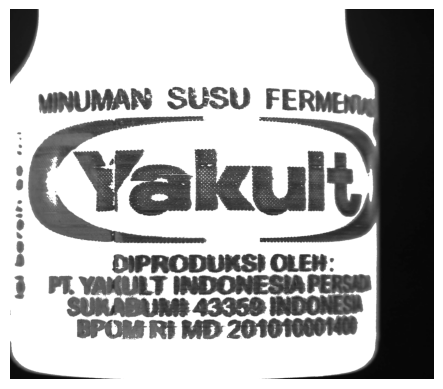

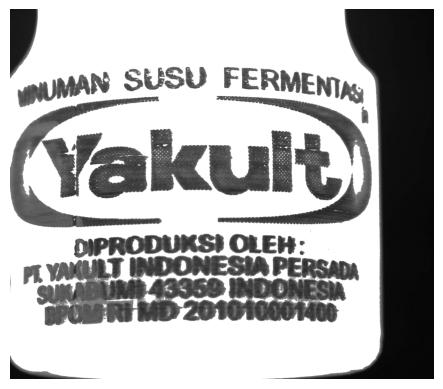

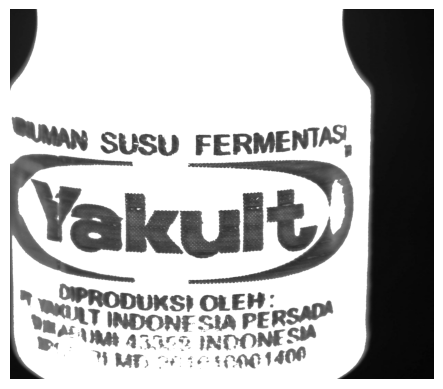

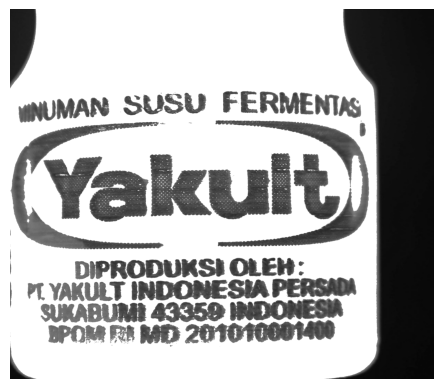

loaded category:Botol Bagus successfully
loading... category : Cat Pudar Botol


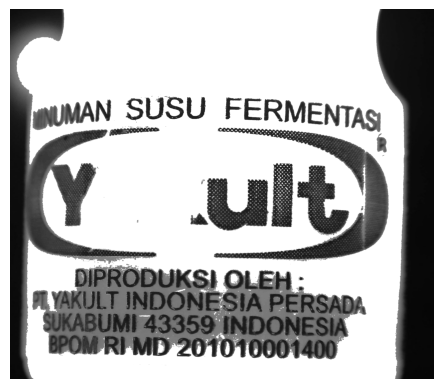

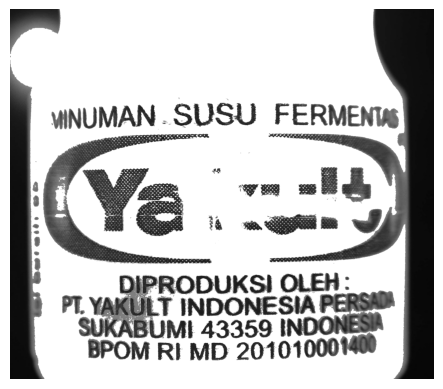

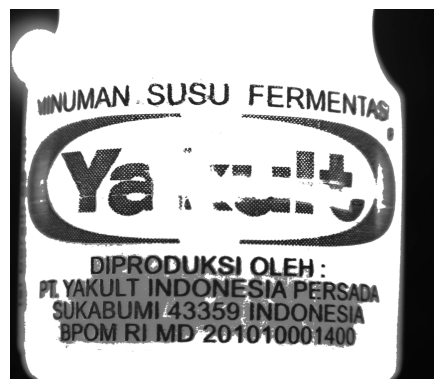

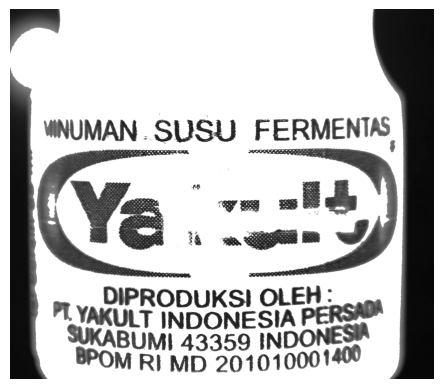

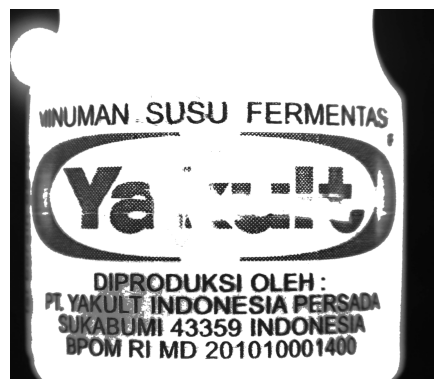

...

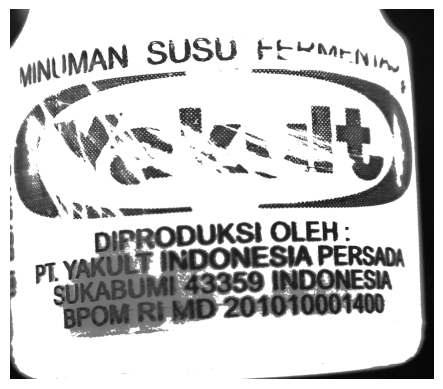

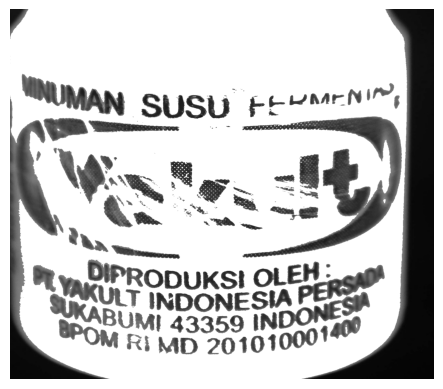

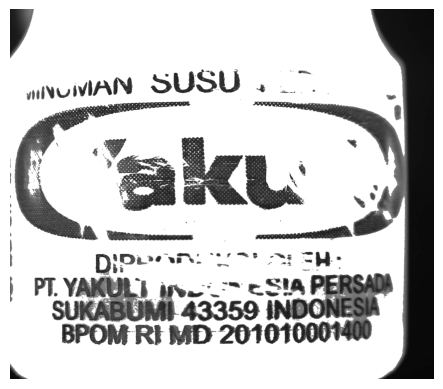

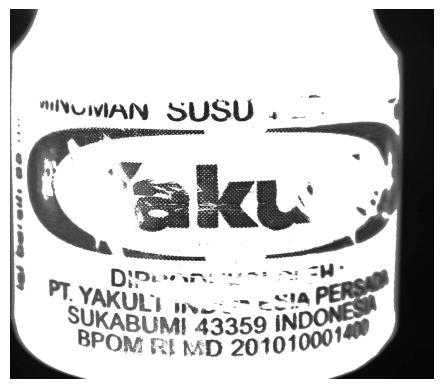

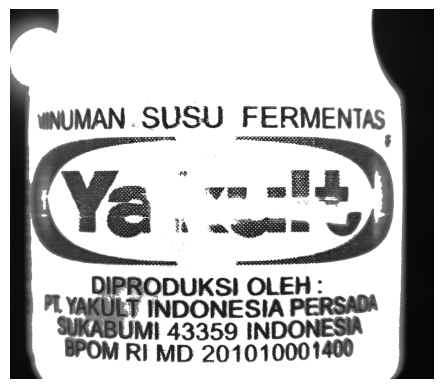

loaded category:Cat Pudar Botol successfully


In [5]:
import pandas as pd 
import os 
from skimage.transform import resize 
from skimage.io import imread 
import numpy as np 
import joblib
import matplotlib.pyplot as plt 
from sklearn import svm 
from sklearn.model_selection import GridSearchCV 
from sklearn.model_selection import train_test_split 
from sklearn.metrics import accuracy_score 
from sklearn.metrics import classification_report

Categories=['Botol Bagus','Cat Pudar Botol'] 
flat_data_arr=[] #input array 
target_arr=[] #output array 
datadir='Dataset V2/' 
#path which contains all the categories of images 
for i in Categories: 
      
    print(f'loading... category : {i}') 
    path=os.path.join(datadir,i) 
    for img in os.listdir(path): 
        #img_array=imread(os.path.join(path,img)) 
        img_process = process_image(os.path.join(path,img))
        img_resized=resize(img_process,(150,150,3))
        flat_data_arr.append(img_resized.flatten()) 
        target_arr.append(Categories.index(i)) 
    print(f'loaded category:{i} successfully') 
flat_data=np.array(flat_data_arr) 
target=np.array(target_arr)


In [7]:
df=pd.DataFrame(flat_data)  
df['Target']=target 
df.shape
print (df)

#input data  
x=df.iloc[:,:-1]  
#output data 
y=df.iloc[:,-1]

# Splitting the data into training and testing sets 
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.20,random_state=1000, stratify=y) 


            0         1         2         3         4         5         6  \
0    0.075951  0.075951  0.075951  0.081015  0.081015  0.081015  0.082339   
1    0.088676  0.088676  0.088676  0.092241  0.092241  0.092241  0.093878   
2    0.102040  0.102040  0.102040  0.104865  0.104865  0.104865  0.107916   
3    0.095016  0.095016  0.095016  0.096291  0.096291  0.096291  0.097956   
4    0.093133  0.093133  0.093133  0.094418  0.094418  0.094418  0.097098   
..        ...       ...       ...       ...       ...       ...       ...   
195  0.131347  0.131347  0.131347  0.152517  0.152517  0.152517  0.201266   
196  0.093536  0.093536  0.093536  0.092616  0.092616  0.092616  0.094657   
197  0.116572  0.116572  0.116572  0.141244  0.141244  0.141244  0.184217   
198  0.098009  0.098009  0.098009  0.098184  0.098184  0.098184  0.099230   
199  0.082411  0.082411  0.082411  0.088057  0.088057  0.088057  0.095288   

            7         8         9  ...     67491     67492     67493  \
0  

In [9]:
# Defining the parameters grid for GridSearchCV 
param_grid={'C':[0.1,1,10,100], 
            'gamma':[0.0001,0.001,0.1,1], 
            'kernel':['poly']} 
  
# Creating a support vector classifier 
svc=svm.SVC(probability=True) 
  
# Creating a model using GridSearchCV with the parameters grid 
model=GridSearchCV(svc,param_grid, return_train_score=True)


In [ ]:
#Train Data

model.fit(x_train,y_train)


## Model Evaluation

The model is 100.0% accurate
                 precision    recall  f1-score   support

    Botol Bagus       1.00      1.00      1.00        20
Cat Pudar Botol       1.00      1.00      1.00        20

       accuracy                           1.00        40
      macro avg       1.00      1.00      1.00        40
   weighted avg       1.00      1.00      1.00        40

Confusion matrix, without normalization
[[20  0]
 [ 0 20]]


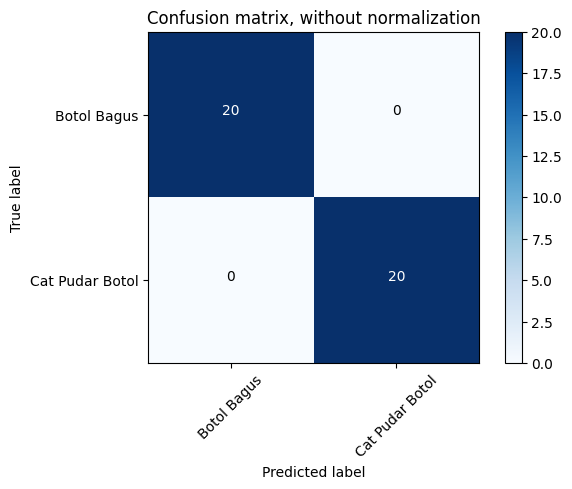

In [14]:
#from sklearn.model_selection import cross_val_score
#from sklearn.model_selection import LeaveOneOut
from sklearn.metrics import classification_report, confusion_matrix
import itertools
import numpy as np
import matplotlib.pyplot as plt

from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
# Testing the model using the testing data 
model_SVM = r'Version 2 Final_SVM.pkl'

loaded_model = joblib.load(model_SVM)

y_pred = loaded_model.predict(x_test) 
  

# Calculating the accuracy of the model 
accuracy = accuracy_score(y_pred, y_test) 

#loo = LeaveOneOut()
#scores = cross_val_score(model, x,y, cv = loo, scoring='accuracy')

#print( scores.mean() )

# Print the accuracy of the model 
print(f"The model is {accuracy*100}% accurate")

print(classification_report(y_test, y_pred, target_names=['Botol Bagus', 'Cat Pudar Botol']))

cf = confusion_matrix(y_test, y_pred)

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

plt.figure()
plot_confusion_matrix(cf, classes=Categories,title='Confusion matrix, without normalization')


## Save Model

In [ ]:
# save the model to disk
filename = 'Final_SVM.pkl'
joblib.dump(model, filename)
 
# load the model from disk
loaded_model = joblib.load(filename)
result = loaded_model.score(x_test, y_test)
print(result)

## Learning Curve

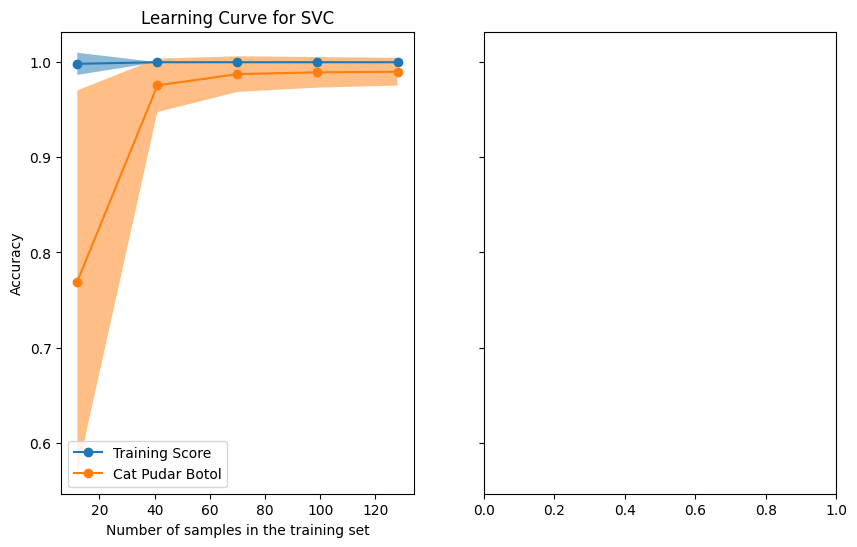

In [12]:
from sklearn.datasets import load_digits
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import numpy as np

from sklearn.model_selection import LearningCurveDisplay, ShuffleSplit

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 6), sharey=True)

common_params = {
    "X": x_train,
    "y": y_train,
    "train_sizes": np.linspace(0.1, 1.0, 5),
    "cv": ShuffleSplit(n_splits=50, test_size=0.2, random_state=0),
    "score_type": "both",
    "n_jobs": 4,
    "line_kw": {"marker": "o"},
    "std_display_style": "fill_between",
    "score_name": "Accuracy",
}

for ax_idx, estimator in enumerate([svc]):
    LearningCurveDisplay.from_estimator(estimator, **common_params, ax=ax[ax_idx])
    handles, label = ax[ax_idx].get_legend_handles_labels()
    ax[ax_idx].legend(handles[:2], ["Training Score", "Test Score"])
    ax[ax_idx].set_title(f"Learning Curve for {estimator.__class__.__name__}")

## Predict From Loaded Model

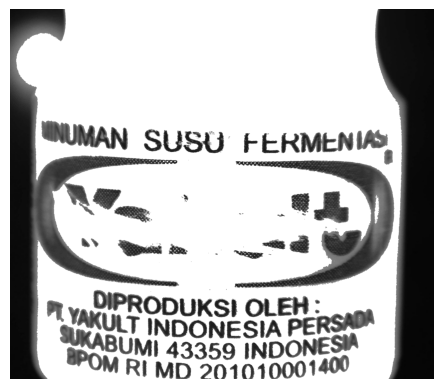

Botol Bagus = 3.840241135294413%
Cat Pudar Botol = 96.1597588647056%
The predicted image is : Cat Pudar Botol


'Yes'

In [4]:
from PIL import Image
import cv2

def process_image(image_path):
    image1 = Image.open(image_path)

    # Langkah 1: Potong gambar
    width, height = image1.size
    x,y = 500,200
    cropped_image = image1.crop((x, y, width-300, height-100))

    # Langkah 2: Konversi ke grayscale
    gray_image = cv2.cvtColor(np.array(cropped_image), cv2.COLOR_BGR2GRAY)

    # Langkah 3: Thresholding
    thresholded_image = gray_image.copy()
    otsu_threshold, image_result = cv2.threshold(thresholded_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    threshold_value = 128
    thresholded_image[gray_image > threshold_value] = 255

    plt.imshow(thresholded_image, cmap='gray') 
    plt.axis('off')
    plt.show()

    return thresholded_image

def SVM_process_image(image_path):
    image1 = Image.open(image_path)

    # Langkah 1: Potong gambar
    width, height = image1.size
    x,y = 400,100
    cropped_image = image1.crop((x, y, width-300, height-800))

    # Langkah 2: Konversi ke grayscale
    gray_image = cv2.cvtColor(np.array(cropped_image), cv2.COLOR_BGR2GRAY)

    # Langkah 3: Thresholding
    thresholded_image = gray_image.copy()
    otsu_threshold, image_result = cv2.threshold(thresholded_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    threshold_value = 128
    thresholded_image[gray_image > threshold_value] = 255

    #plt.imshow(thresholded_image, cmap='gray') 
    #plt.axis('off')
    #plt.show()

    return thresholded_image

def model_1(image):
# load the model from disk
    Categories=['Botol Bagus','Cat Pudar Botol'] 
    model_SVM = r'Final_SVM.pkl'

    loaded_model = joblib.load(model_SVM)
    image1 = SVM_process_image(image_path)
    #img_path = Image.open(image)
    #img=imread(image1) 
    #plt.imshow(img) 
    #plt.axis('off')
    #plt.show() 

    img_resize=resize(image1,(150,150,3)) 
    l=[img_resize.flatten()] 
    probability=loaded_model.predict_proba(l) 
    CategoryClass = Categories[loaded_model.predict(l)[0]]
    if CategoryClass == "Cat Pudar Botol":
        kesimpulan = 'Yes' #Botol Pudar?
    else :
        kesimpulan = "No" #Botol Bagus?
    for ind,val in enumerate(Categories): 
        print(f'{val} = {probability[0][ind]*100}%') 
    print("The predicted image is : "+Categories[loaded_model.predict(l)[0]])
    return kesimpulan

image_path = r'Dataset V2/Testing/Cat Pudar Botol/WIN_20240401_19_25_45_Pro.jpg'
#image_path = r'Dataset V2/Testing/Bagus/WIN_20240315_08_56_07_Pro.jpg'
#image_path = r'Dataset V2/Testing/Pudar/WIN_20240315_09_03_57_Pro.jpg'
#image_path = r'Dataset/Botol Bagus/WIN_20240302_23_40_52_Pro.jpg'
process_image(image_path)
model_1(image_path)  



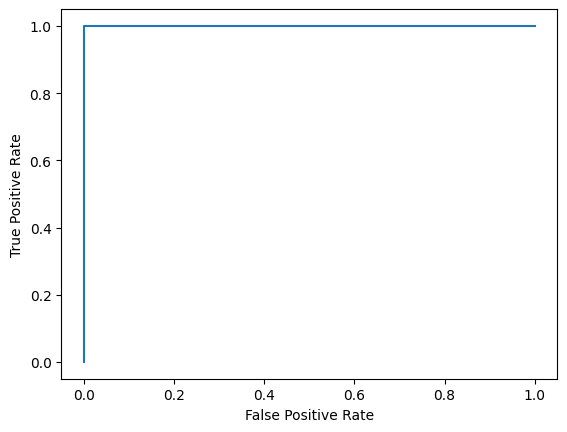

In [112]:
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import RocCurveDisplay, roc_curve

Categories=['Botol Bagus','Cat Pudar Botol'] 

model_SVM = r'Final_SVM.pkl'

loaded_model = joblib.load(model_SVM)

y_score = loaded_model.decision_function(x_test)

fpr, tpr, _ = roc_curve(y_test, y_score, pos_label=loaded_model.classes_[1])
roc_display = RocCurveDisplay(fpr=fpr, tpr=tpr).plot()

0


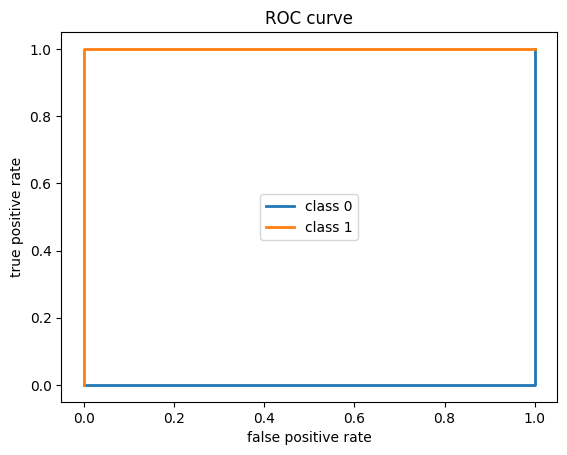

In [110]:
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import RocCurveDisplay, roc_curve

Categories=['Botol Bagus','Cat Pudar Botol'] 
model_SVM = r'Final_SVM.pkl'

loaded_model = joblib.load(model_SVM)

y_score = loaded_model.predict_proba(x_test)

pos_label=loaded_model.classes_[0]

print(pos_label)
# roc curve
fpr = dict()
tpr = dict()

for i in range(2):
    fpr[i], tpr[i], _ = roc_curve(y_test,y_score[:, i])
    plt.plot(fpr[i], tpr[i], lw=2, label='class {}'.format(i))

plt.xlabel("false positive rate")
plt.ylabel("true positive rate")
plt.legend(loc="best")
plt.title("ROC curve")
plt.show()